In [1]:
import os
import time
import random
import collections

import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

import torch
import torchvision
from torchvision.transforms import ToPILImage
from torchvision.transforms import functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchvision.transforms import ToPILImage
from torchvision.transforms.functional import to_tensor
from matplotlib.patches import Rectangle
from skimage import exposure
from torchvision.transforms.functional import to_pil_image
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Subset

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
class CellDataset(torch.utils.data.Dataset):
    def __init__(self, annotations_file, images_dir, transforms=None):
        self.transforms = transforms
        self.annotations_df = pd.read_excel(annotations_file)
        self.images_dir = images_dir

    def __len__(self):
        return len(self.annotations_df['id'].unique())

    def __getitem__(self, idx):
        # Initialize replay to None or a default value
        replay = None
        
        # Get the image ID and filter annotations for this image
        image_id = self.annotations_df['id'].unique()[idx]
        image_annotations = self.annotations_df[self.annotations_df['id'] == image_id]

        # Load the image
        image_path = os.path.join(self.images_dir, f'{image_id}.tif')
        image = Image.open(image_path)

        # Convert the image to a NumPy array and normalize
        image_np = np.array(image)
        max_pixel_value = 65535.0
        image_normalized = image_np / max_pixel_value
        image_np = image_normalized.astype(np.float32)
        
        # Convert the original image to tensor before applying transforms
        original_image = to_tensor(image_np)

        # Initialize lists to collect valid masks and bounding boxes
        valid_masks = []
        valid_boxes = []

        # Loop through annotations, decode the RLE, and calculate bounding boxes
        for _, row in image_annotations.iterrows():
            rle = row['annotation']
            decoded_mask = self.rle_to_mask(rle, (row['width'], row['height']))

            # Threshold the mask to ensure it's binary
            decoded_mask = decoded_mask > 0

            # Calculate bounding box
            box = self.get_box(decoded_mask)

            # Check if the bounding box is valid
            if box is not None and box[2] > box[0] and box[3] > box[1]:  # Valid bbox
                valid_masks.append(decoded_mask)
                valid_boxes.append(box)

        # Convert valid masks to a multi-channel array and boxes to tensors
        if valid_masks:
            valid_masks = np.stack(valid_masks, axis=0)
            
        # Assuming 'labels' is a list of labels corresponding to each 'valid_boxes'
        labels = [1] * len(valid_boxes)  # This is an example, replace with actual labels if they vary

        
        # Create the original target dictionary with untransformed masks and boxes
        original_target = {
            'boxes': torch.as_tensor(valid_boxes, dtype=torch.float32),
            'labels': torch.ones((len(valid_boxes),), dtype=torch.int64),  # Assuming one class
            'masks': torch.as_tensor(valid_masks, dtype=torch.uint8),
        }

        

        # augment image and targets
        if self.transforms is not None:
            bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']}
            augs = A.ReplayCompose(self.transforms, bbox_params=bbox_params, p=1)       
            augmented = augs(image=image_np, masks=valid_masks, bboxes=valid_boxes, labels=labels)    
            image = augmented['image']
            masks = augmented['masks']
            boxes = augmented['bboxes'] 
            labels = augmented['labels']
            replay = augmented['replay']
        else:
            # Assign masks and boxes from valid_masks and valid_boxes if no transforms
            masks = valid_masks
            boxes = valid_boxes
            

            
        # Convert list of numpy arrays to a single numpy array
        if len(masks) > 0:  # Check if the list is non-empty
            masks = np.stack(masks, axis=0)
        else:
            # Create an empty numpy array with shape (0, height, width)
            # Assuming image_np has shape (channels, height, width)
            masks = np.zeros((0, image_np.shape[1], image_np.shape[2]), dtype=np.uint8)
            
        image = to_tensor(image)
        masks = torch.as_tensor(masks, dtype=torch.uint8)
        boxes = torch.as_tensor(boxes, dtype=torch.float32)

        # Create the target dictionary with only valid masks and boxes
        target = {
            'boxes': boxes,
            'labels': torch.ones((len(boxes),), dtype=torch.int64),  # Assuming one class
            'masks': masks,
        }

        return original_image, original_target, image, target, replay


    def rle_to_mask(self, rle, shape):
        # Split the RLE string
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0::2], s[1::2])]
        starts -= 1
        ends = starts + lengths
        img = np.zeros(shape[0] * shape[1], dtype=np.uint8)
        for lo, hi in zip(starts, ends):
            img[lo:hi] = 1
        # Reshape and transpose the mask
        return img.reshape((shape[1], shape[0]), order='F')


    def get_box(self, mask):
        ''' Get the bounding box of a given mask '''
        pos = np.where(mask)
        xmin = np.min(pos[1])
        xmax = np.max(pos[1])
        ymin = np.min(pos[0])
        ymax = np.max(pos[0])
        return [xmin, ymin, xmax, ymax]

    # Method to visualize the image along with its masks and bounding boxes
    def visualize_image_with_masks_and_boxes(self, idx, alpha=0.5):
        # Retrieve the image and its related targets (masks and bounding boxes)
        _, _, image, target,_ = self[idx]

        # Convert tensor to numpy array for displaying
        if image.shape[0] == 1:
            # If grayscale, squeeze the channel dimension and convert to numpy
            display_image = image.squeeze().numpy()
        else:
            # If RGB, convert to numpy and transpose the axes for displaying
            display_image = image.permute(1, 2, 0).numpy()

        # Create a figure and axis for plotting
        fig, ax = plt.subplots(1, figsize=(12, 12))

        # Display the image
        cmap = 'gray' if image.shape[0] == 1 else None
        ax.imshow(display_image, cmap=cmap, aspect='auto')

        # Overlay all masks on the image with the specified alpha for transparency
        for mask in target['masks']:
            # Reshape mask if it has an extra dimension
            if mask.ndim == 3:
                mask = mask.squeeze(0)

            # Create an RGBA representation of the mask
            mask_rgba = np.zeros((mask.size(0), mask.size(1), 4), dtype=np.uint8)
            mask_rgba[..., :3] = np.array([255, 0, 0], dtype=np.uint8)  # Red color
            mask_rgba[..., 3] = (mask.numpy() * 255).astype(np.uint8)  # Alpha channel

            # Convert to PIL for alpha blending
            mask_pil = Image.fromarray(mask_rgba, mode='RGBA')
            ax.imshow(mask_pil, alpha=alpha)

        # Draw bounding boxes on top of the masks
        for box in target['boxes']:
            # Ensure box is a NumPy array
            box_np = box.numpy() if torch.is_tensor(box) else box

            # Calculate width and height of the box
            width = box_np[2] - box_np[0]
            height = box_np[3] - box_np[1]

            # Create a Rectangle patch
            rect = Rectangle(
                (box_np[0], box_np[1]),  # Top-left corner (xmin, ymin)
                width,                   # Width of the box
                height,                  # Height of the box
                linewidth=1,
                edgecolor='blue',
                facecolor='none'
            )
            # Add the patch to the Axes
            ax.add_patch(rect)

        # Hide the axes and grid lines
        ax.axis('off')

        # Show the plot
        plt.show()




In [3]:
cell_dataset = CellDataset('/kaggle/input/mask-annotations-x/mask_annotations2.xlsx',
                           '/kaggle/input/images-masks/images (.tiff)+ mask/images .tiff')


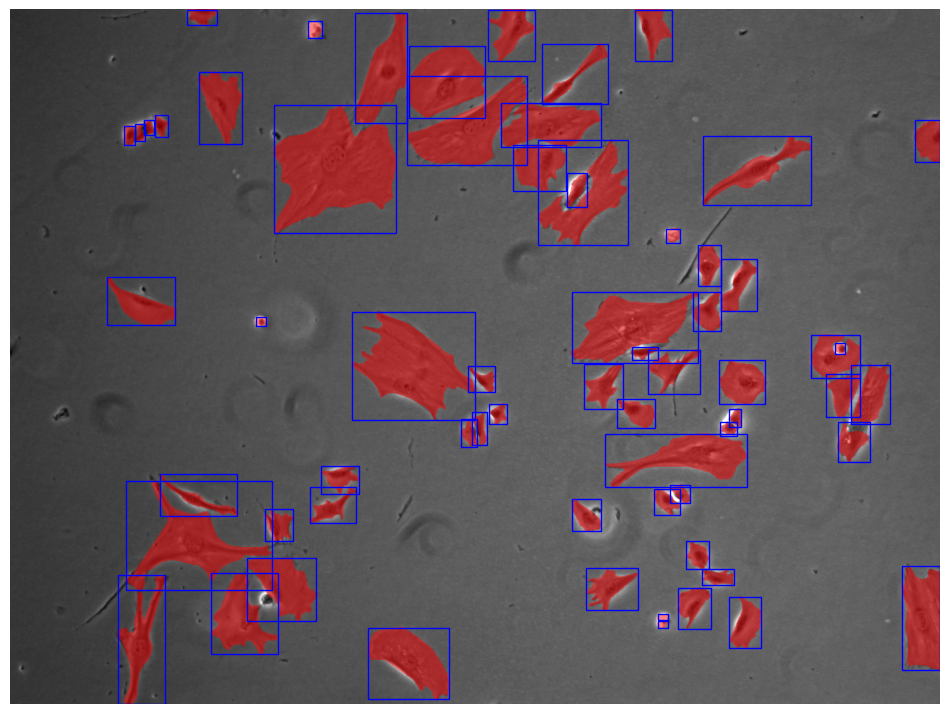

In [4]:
cell_dataset.visualize_image_with_masks_and_boxes(0)

In [5]:
def apply_clahe(image, clip_limit=0.5, **kwargs):
    """
    Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to an image.

    Parameters:
    - image: Input image.
    - clip_limit: Clip limit for CLAHE.
    - kwargs: Additional keyword arguments.

    Returns:
    - Processed image with CLAHE applied.
    """
    # Convert image to float32 for processing
    image_float = image.astype(np.float32)

    # Applying CLAHE
    image_clahe = exposure.equalize_adapthist(image_float, clip_limit=clip_limit)

    # Return the processed image in float32 with normalized range [0, 1]
    return image_clahe.astype(np.float32)

# Define D4 transformations
D4_transforms = [
    A.HorizontalFlip(p=1),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.Transpose(p=0.5),                   
]

# Define DeepSea transformations
transforms_deepsea = [

    A.Lambda(image=apply_clahe, name='apply_clahe'),
    A.GaussNoise(var_limit=(0.005, 0.005), p=1),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.3),
    A.GaussianBlur(blur_limit=(3, 7), p=0.3),
]


In [6]:
def custom_collate_fn(batch):
    return tuple(zip(*batch))

# Instantiate the training dataset with corrected paths
cell_dataset = CellDataset('../input/mask-annotations-x/mask_annotations2.xlsx',
                           '../input/images-masks/images (.tiff)+ mask/images .tiff',
                           transforms = transforms_deepsea)


train_dataloader = DataLoader(cell_dataset, batch_size=4, num_workers=2, shuffle=True)

# Assuming you have an array of indices to split, e.g., np.arange(len(train_dataset))
indices = np.arange(len(cell_dataset))

# Split indices into train and validation sets
train_indices, val_indices = train_test_split(indices, test_size=0.2, random_state=42)

# Creating PyTorch datasets for train and validation, ensuring transforms are applied
train_subset = Subset(cell_dataset, train_indices)
val_subset = Subset(cell_dataset, val_indices)

# Create dataloaders for train and validation sets with the transforms_deepsea applied
train_dataloader = DataLoader(train_subset, batch_size=2, shuffle=False, num_workers=2, collate_fn=custom_collate_fn)
validation_dataloader = DataLoader(val_subset, batch_size=2, shuffle=False, num_workers=2, collate_fn=custom_collate_fn)



In [7]:
import os

# Print the current working directory
print("Current Working Directory:", os.getcwd())

# Your relative paths
annotations_path = '../input/mask-annotations-x/mask_annotations2.xlsx'
images_path = '../input/images-masks/images (.tiff)+ mask/images .tiff'

# Check if the files exist
if not os.path.exists(annotations_path):
    print(f"File not found: {annotations_path}")
if not os.path.exists(images_path):
    print(f"File not found: {images_path}")

Current Working Directory: /kaggle/working


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


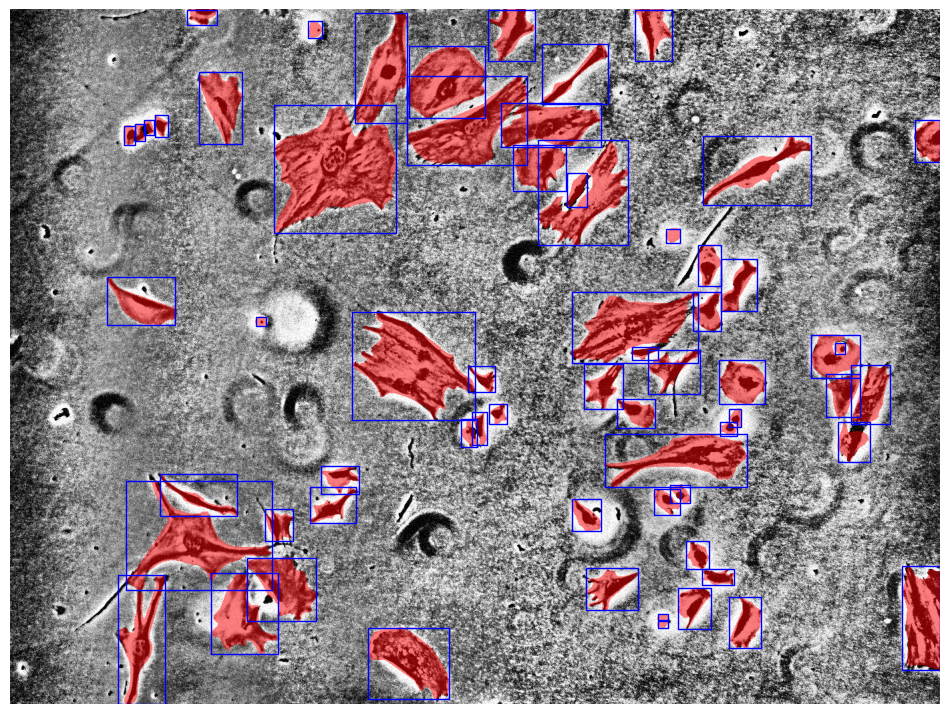

In [8]:
cell_dataset.visualize_image_with_masks_and_boxes(0)

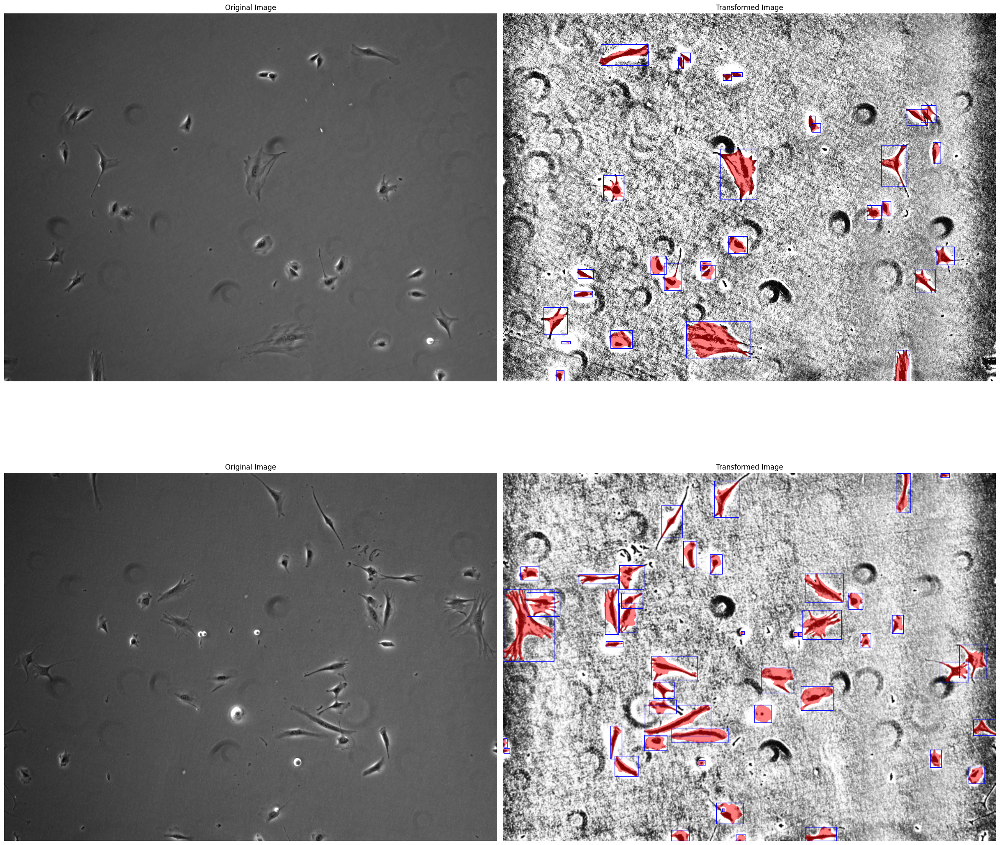

In [9]:
def visualize_batch_with_masks_and_boxes(dataloader, alpha=0.5):
    # Get a single batch of data
    batch = next(iter(dataloader))
    original_images, _,images, targets,_ = batch

    # Number of images in the batch
    batch_size = len(images)

    # Create a figure to hold subplots for each pair of original and transformed images
    fig, axes = plt.subplots(batch_size, 2, figsize=(24, 12 * batch_size))  # 2 columns for each pair

    # Ensure axes is a 2D array even if batch_size is 1
    if batch_size == 1:
        axes = np.array([axes])

    # Loop through the batch
    for idx in range(batch_size):
        # Original image subplot
        original_ax = axes[idx][0]
        # Transformed image subplot
        transformed_ax = axes[idx][1]

        # Display the original image
        original_image = original_images[idx].permute(1, 2, 0).numpy()
        original_ax.imshow(original_image, cmap='gray' if original_images[idx].shape[0] == 1 else None)
        original_ax.set_title('Original Image')
        original_ax.axis('off')

        # Display the transformed image
        transformed_image = images[idx].permute(1, 2, 0).numpy()
        transformed_ax.imshow(transformed_image, cmap='gray' if images[idx].shape[0] == 1 else None)
        transformed_ax.set_title('Transformed Image')

        # Overlay masks and bounding boxes on the transformed image
        for mask, box in zip(targets[idx]['masks'], targets[idx]['boxes']):
            # Overlay mask
            mask_rgba = np.zeros((mask.size(0), mask.size(1), 4), dtype=np.uint8)
            mask_rgba[..., :3] = np.array([255, 0, 0], dtype=np.uint8)  # Red color
            mask_rgba[..., 3] = (mask.numpy() * 255).astype(np.uint8)  # Alpha channel
            mask_pil = Image.fromarray(mask_rgba, mode='RGBA')
            transformed_ax.imshow(mask_pil, alpha=alpha)

            # Draw bounding box
            box_np = box.numpy()
            rect = Rectangle(
                (box_np[0], box_np[1]),  # Top-left corner (xmin, ymin)
                box_np[2] - box_np[0],   # Width of the box
                box_np[3] - box_np[1],   # Height of the box
                linewidth=1,
                edgecolor='blue',
                facecolor='none'
            )
            transformed_ax.add_patch(rect)

        # Hide the axes and grid lines for transformed image subplot
        transformed_ax.axis('off')

    # Show the plot
    plt.tight_layout()
    plt.show()

# Example usage with a DataLoader:
visualize_batch_with_masks_and_boxes(train_dataloader)

In [11]:
# Assuming `dl_train` is your DataLoader instance.

# Get one batch from the DataLoader
batch = next(iter(train_dataloader))

# Unpack the batch
_, _, images, targets,_ = batch

# Print the shapes of the images and targets
print("Batch Shapes:")
print(f"Number of images in the batch: {len(images)}")
for i, image in enumerate(images):
    print(f"Shape of image {i}: {image.shape}")

print(f"Number of target dicts in the batch: {len(targets)}")
for i, target in enumerate(targets):
    print(f"Shape of boxes for image {i}: {target['boxes'].shape}")
    print(f"Shape of labels for image {i}: {target['labels'].shape}")
    print(f"Shape of masks for image {i}: {target['masks'].shape}")
    

# Fetch a batch of images
_,_, images, _, _ = next(iter(train_dataloader))

# Check and print the datatype of each image
for i, image in enumerate(images):
    print(f"Image {i} datatype: {image.dtype}")  # This prints the datatype of the image

# We'll execute only the datatype check part and not visualize to keep the response focused on the datatype check.


Batch Shapes:
Number of images in the batch: 2
Shape of image 0: torch.Size([1, 1040, 1392])
Shape of image 1: torch.Size([1, 1040, 1392])
Number of target dicts in the batch: 2
Shape of boxes for image 0: torch.Size([31, 4])
Shape of labels for image 0: torch.Size([31])
Shape of masks for image 0: torch.Size([31, 1040, 1392])
Shape of boxes for image 1: torch.Size([47, 4])
Shape of labels for image 1: torch.Size([47])
Shape of masks for image 1: torch.Size([47, 1040, 1392])
Image 0 datatype: torch.float32
Image 1 datatype: torch.float32


In [12]:
WIDTH = 1392
HEIGHT = 1040

# Reduced the train dataset to 5000 rows
TEST = False

DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# No changes tried with the optimizer yet.
MOMENTUM = 0.9
LEARNING_RATE = 0.001
WEIGHT_DECAY = 0.0005

# Changes the confidence required for a pixel to be kept for a mask. 
# Only used 0.5 till now.
MASK_THRESHOLD = 0.5


# Use a StepLR scheduler if True. Not tried yet.
USE_SCHEDULER = False

# Number of epochs
NUM_EPOCHS = 20


BOX_DETECTIONS_PER_IMG = 539


MIN_SCORE = 0.59

In [13]:
# Assuming train_dataloader and validation_dataloader are already defined

# Calculate the number of images in the training dataloader
train_images_count = len(train_dataloader.dataset)

# Calculate the number of images in the validation dataloader
validation_images_count = len(validation_dataloader.dataset)

print(f"Number of images in the training dataloader: {train_images_count}")
print(f"Number of images in the validation dataloader: {validation_images_count}")


Number of images in the training dataloader: 384
Number of images in the validation dataloader: 96


In [14]:
# Override pythorch checkpoint with an "offline" version of the file
!mkdir -p /root/.cache/torch/hub/checkpoints/
!cp ../input/cocopre3/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth

In [18]:
def get_model(num_classes):
    # Load a model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask, hidden_layer, num_classes)
    return model

# Load the model
num_classes = 2  # define the number of classes in your dataset
model = get_model(num_classes)

# Load the pretrained weights
weights_path = '/kaggle/input/weights-40-epochs/pytorch_model-e40.bin'
model.load_state_dict(torch.load(weights_path))

# Move model to the right device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Set model to training mode
model.train()

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [14]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=LEARNING_RATE, momentum=MOMENTUM, weight_decay=WEIGHT_DECAY)

lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

n_batches = len(train_dataloader)

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Starting epoch {epoch} of {NUM_EPOCHS}")
    
    time_start = time.time()
    loss_accum = 0.0
    loss_mask_accum = 0.0
    
    for batch_idx, (_, _, images, targets, _) in enumerate(train_dataloader, 1):
    
        # Predict
        images = list(image.to(DEVICE) for image in images)
        targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        
        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Logging
        loss_mask = loss_dict['loss_mask'].item()
        loss_accum += loss.item()
        loss_mask_accum += loss_mask
        
        if batch_idx % 50 == 0:
            print(f"    [Batch {batch_idx:3d} / {n_batches:3d}] Batch train loss: {loss.item():7.3f}. Mask-only loss: {loss_mask:7.3f}")
    
    if USE_SCHEDULER:
        lr_scheduler.step()
    
    # Train losses
    train_loss = loss_accum / n_batches
    train_loss_mask = loss_mask_accum / n_batches
    
    
    elapsed = time.time() - time_start
    
    
    torch.save(model.state_dict(), f"pytorch_model-e{epoch}.bin")
    prefix = f"[Epoch {epoch:2d} / {NUM_EPOCHS:2d}]"
    print(f"{prefix} Train mask-only loss: {train_loss_mask:7.3f}")
    print(f"{prefix} Train loss: {train_loss:7.3f}. [{elapsed:.0f} secs]")
     

Starting epoch 1 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.732. Mask-only loss:   0.212
    [Batch 100 / 192] Batch train loss:   0.666. Mask-only loss:   0.196
    [Batch 150 / 192] Batch train loss:   0.685. Mask-only loss:   0.210
[Epoch  1 / 20] Train mask-only loss:   0.221
[Epoch  1 / 20] Train loss:   0.755. [166 secs]
Starting epoch 2 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.718. Mask-only loss:   0.219
    [Batch 100 / 192] Batch train loss:   0.600. Mask-only loss:   0.191
    [Batch 150 / 192] Batch train loss:   0.681. Mask-only loss:   0.224
[Epoch  2 / 20] Train mask-only loss:   0.220
[Epoch  2 / 20] Train loss:   0.743. [151 secs]
Starting epoch 3 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.718. Mask-only loss:   0.230
    [Batch 100 / 192] Batch train loss:   0.599. Mask-only loss:   0.198
    [Batch 150 / 192] Batch train loss:   0.634. Mask-only loss:   0.207
[Epoch  3 / 20] Train mask-only loss:   0.219
[Epoch  3 / 20] Train loss:   0.741. [153 secs]
Starting epoch 4 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.688. Mask-only loss:   0.208
    [Batch 100 / 192] Batch train loss:   0.612. Mask-only loss:   0.197
    [Batch 150 / 192] Batch train loss:   0.714. Mask-only loss:   0.210
[Epoch  4 / 20] Train mask-only loss:   0.219
[Epoch  4 / 20] Train loss:   0.731. [152 secs]
Starting epoch 5 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.697. Mask-only loss:   0.221
    [Batch 100 / 192] Batch train loss:   0.598. Mask-only loss:   0.191
    [Batch 150 / 192] Batch train loss:   0.623. Mask-only loss:   0.211
[Epoch  5 / 20] Train mask-only loss:   0.217
[Epoch  5 / 20] Train loss:   0.718. [152 secs]
Starting epoch 6 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.645. Mask-only loss:   0.201
    [Batch 100 / 192] Batch train loss:   0.592. Mask-only loss:   0.200
    [Batch 150 / 192] Batch train loss:   0.629. Mask-only loss:   0.204
[Epoch  6 / 20] Train mask-only loss:   0.217
[Epoch  6 / 20] Train loss:   0.709. [151 secs]
Starting epoch 7 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.641. Mask-only loss:   0.205
    [Batch 100 / 192] Batch train loss:   0.537. Mask-only loss:   0.185
    [Batch 150 / 192] Batch train loss:   0.638. Mask-only loss:   0.205
[Epoch  7 / 20] Train mask-only loss:   0.215
[Epoch  7 / 20] Train loss:   0.703. [152 secs]
Starting epoch 8 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.711. Mask-only loss:   0.216
    [Batch 100 / 192] Batch train loss:   0.574. Mask-only loss:   0.183
    [Batch 150 / 192] Batch train loss:   0.602. Mask-only loss:   0.201
[Epoch  8 / 20] Train mask-only loss:   0.215
[Epoch  8 / 20] Train loss:   0.696. [152 secs]
Starting epoch 9 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.607. Mask-only loss:   0.203
    [Batch 100 / 192] Batch train loss:   0.592. Mask-only loss:   0.188
    [Batch 150 / 192] Batch train loss:   0.615. Mask-only loss:   0.200
[Epoch  9 / 20] Train mask-only loss:   0.214
[Epoch  9 / 20] Train loss:   0.691. [154 secs]
Starting epoch 10 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.611. Mask-only loss:   0.202
    [Batch 100 / 192] Batch train loss:   0.577. Mask-only loss:   0.197
    [Batch 150 / 192] Batch train loss:   0.593. Mask-only loss:   0.187
[Epoch 10 / 20] Train mask-only loss:   0.214
[Epoch 10 / 20] Train loss:   0.685. [151 secs]
Starting epoch 11 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.617. Mask-only loss:   0.201
    [Batch 100 / 192] Batch train loss:   0.604. Mask-only loss:   0.205
    [Batch 150 / 192] Batch train loss:   0.633. Mask-only loss:   0.205
[Epoch 11 / 20] Train mask-only loss:   0.213
[Epoch 11 / 20] Train loss:   0.679. [153 secs]
Starting epoch 12 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.625. Mask-only loss:   0.211
    [Batch 100 / 192] Batch train loss:   0.557. Mask-only loss:   0.182
    [Batch 150 / 192] Batch train loss:   0.651. Mask-only loss:   0.221
[Epoch 12 / 20] Train mask-only loss:   0.212
[Epoch 12 / 20] Train loss:   0.674. [153 secs]
Starting epoch 13 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.642. Mask-only loss:   0.207
    [Batch 100 / 192] Batch train loss:   0.539. Mask-only loss:   0.187
    [Batch 150 / 192] Batch train loss:   0.578. Mask-only loss:   0.205
[Epoch 13 / 20] Train mask-only loss:   0.211
[Epoch 13 / 20] Train loss:   0.664. [154 secs]
Starting epoch 14 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.570. Mask-only loss:   0.198
    [Batch 100 / 192] Batch train loss:   0.526. Mask-only loss:   0.180
    [Batch 150 / 192] Batch train loss:   0.671. Mask-only loss:   0.233
[Epoch 14 / 20] Train mask-only loss:   0.211
[Epoch 14 / 20] Train loss:   0.666. [152 secs]
Starting epoch 15 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.625. Mask-only loss:   0.211
    [Batch 100 / 192] Batch train loss:   0.573. Mask-only loss:   0.190
    [Batch 150 / 192] Batch train loss:   0.650. Mask-only loss:   0.214
[Epoch 15 / 20] Train mask-only loss:   0.210
[Epoch 15 / 20] Train loss:   0.662. [151 secs]
Starting epoch 16 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.616. Mask-only loss:   0.199
    [Batch 100 / 192] Batch train loss:   0.563. Mask-only loss:   0.184
    [Batch 150 / 192] Batch train loss:   0.610. Mask-only loss:   0.221
[Epoch 16 / 20] Train mask-only loss:   0.209
[Epoch 16 / 20] Train loss:   0.667. [155 secs]
Starting epoch 17 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.623. Mask-only loss:   0.198
    [Batch 100 / 192] Batch train loss:   0.528. Mask-only loss:   0.185
    [Batch 150 / 192] Batch train loss:   0.557. Mask-only loss:   0.204
[Epoch 17 / 20] Train mask-only loss:   0.208
[Epoch 17 / 20] Train loss:   0.651. [152 secs]
Starting epoch 18 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.600. Mask-only loss:   0.197
    [Batch 100 / 192] Batch train loss:   0.527. Mask-only loss:   0.179
    [Batch 150 / 192] Batch train loss:   0.606. Mask-only loss:   0.202
[Epoch 18 / 20] Train mask-only loss:   0.207
[Epoch 18 / 20] Train loss:   0.642. [152 secs]
Starting epoch 19 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.592. Mask-only loss:   0.198
    [Batch 100 / 192] Batch train loss:   0.586. Mask-only loss:   0.191
    [Batch 150 / 192] Batch train loss:   0.581. Mask-only loss:   0.194
[Epoch 19 / 20] Train mask-only loss:   0.208
[Epoch 19 / 20] Train loss:   0.649. [151 secs]
Starting epoch 20 of 20


/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(
/opt/conda/lib/python3.10/site-packages/albumentations/core/transforms_interface.py:113: UserWarning: GaussNoise could work incorrectly in ReplayMode for other input data because its' params depend on targets.
  warn(


    [Batch  50 / 192] Batch train loss:   0.632. Mask-only loss:   0.191
    [Batch 100 / 192] Batch train loss:   0.542. Mask-only loss:   0.181
    [Batch 150 / 192] Batch train loss:   0.563. Mask-only loss:   0.193
[Epoch 20 / 20] Train mask-only loss:   0.206
[Epoch 20 / 20] Train loss:   0.639. [152 secs]


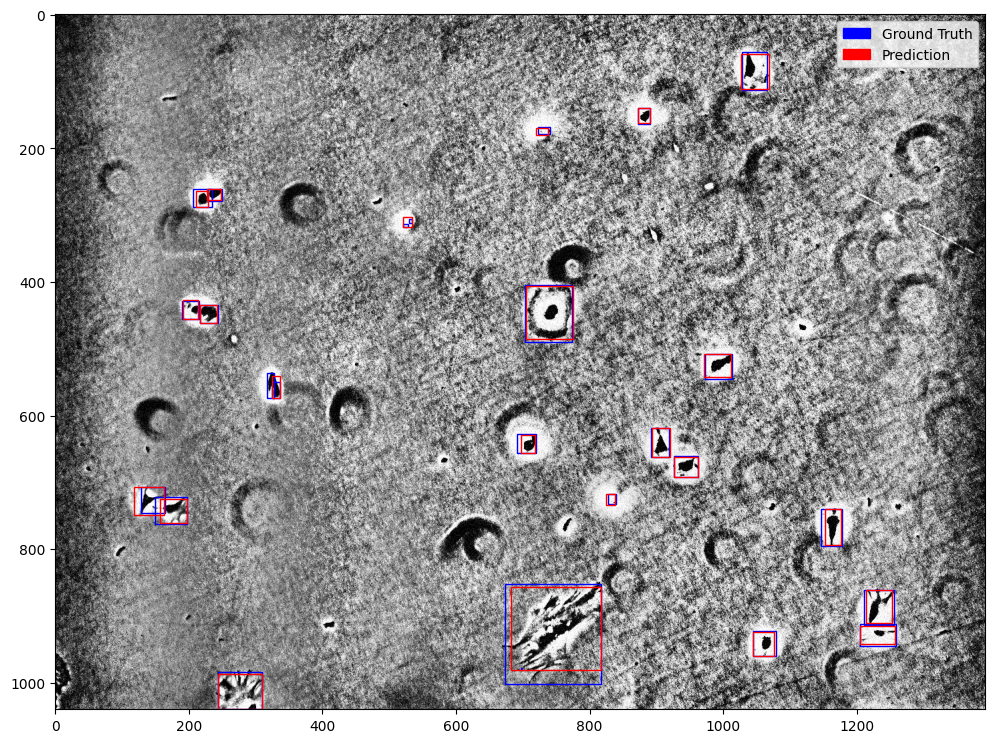

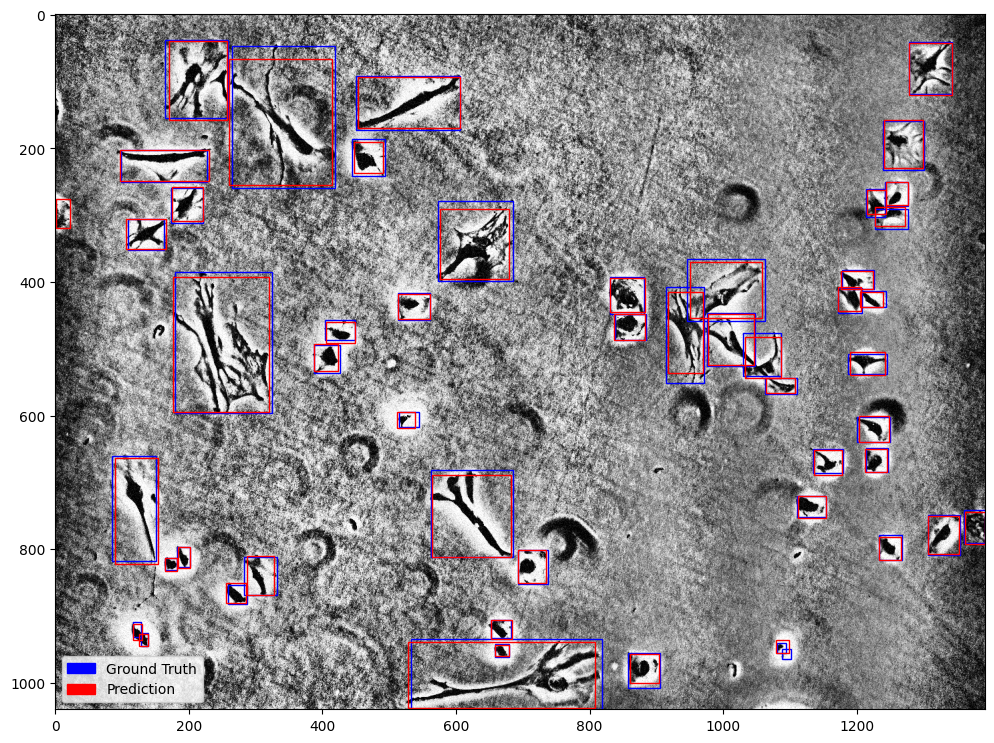

In [25]:
import torch
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from torchvision.ops import nms

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load the model
model_path = '/kaggle/input/weights-40-epochs/pytorch_model-e40.bin'  # Updated model path
model = get_model(num_classes)  # Replace with your model's initialization method
model.load_state_dict(torch.load(model_path, map_location=device))

# Specify the device
model = model.to(device)
model.eval()

# Get a batch of data from the validation dataloader
_, _, images, targets, _ = next(iter(validation_dataloader))  # Use validation_dataloader

# Move images to the same device as model
images = [image.to(device) for image in images]

# Define the NMS threshold
nms_thresh = 0.1  # You can tune this threshold

# Get predictions
with torch.no_grad():
    raw_predictions = model(images)
    predictions = []
    for prediction in raw_predictions:
        keep = nms(prediction['boxes'], prediction['scores'], nms_thresh)
        predictions.append({
            'boxes': prediction['boxes'][keep],
            'scores': prediction['scores'][keep],
            'labels': prediction['labels'][keep],
        })

# Visualization function
def visualize_prediction(image, target, prediction):
    image_np = image.cpu().detach().permute(1, 2, 0).numpy()  # Permute to put channels last
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image_np, cmap='gray')
    
    handles = [Rectangle((0, 0), 1, 1, color='blue'),
               Rectangle((0, 0), 1, 1, color='red')]
    labels = ['Ground Truth', 'Prediction']
    
    for box in target['boxes']:
        rect = Rectangle((box[0].item(), box[1].item()),
                         box[2].item() - box[0].item(),
                         box[3].item() - box[1].item(),
                         linewidth=1, edgecolor='blue', facecolor='none')
        ax.add_patch(rect)
    
    for box in prediction['boxes']:
        rect = Rectangle((box[0].item(), box[1].item()),
                         box[2].item() - box[0].item(),
                         box[3].item() - box[1].item(),
                         linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
    
    ax.legend(handles, labels)
    plt.show()

# Visualize the first few images in the batch
for i in range(min(len(images), 5)):  # Visualize the specified number of images
    visualize_prediction(images[i], targets[i], predictions[i])


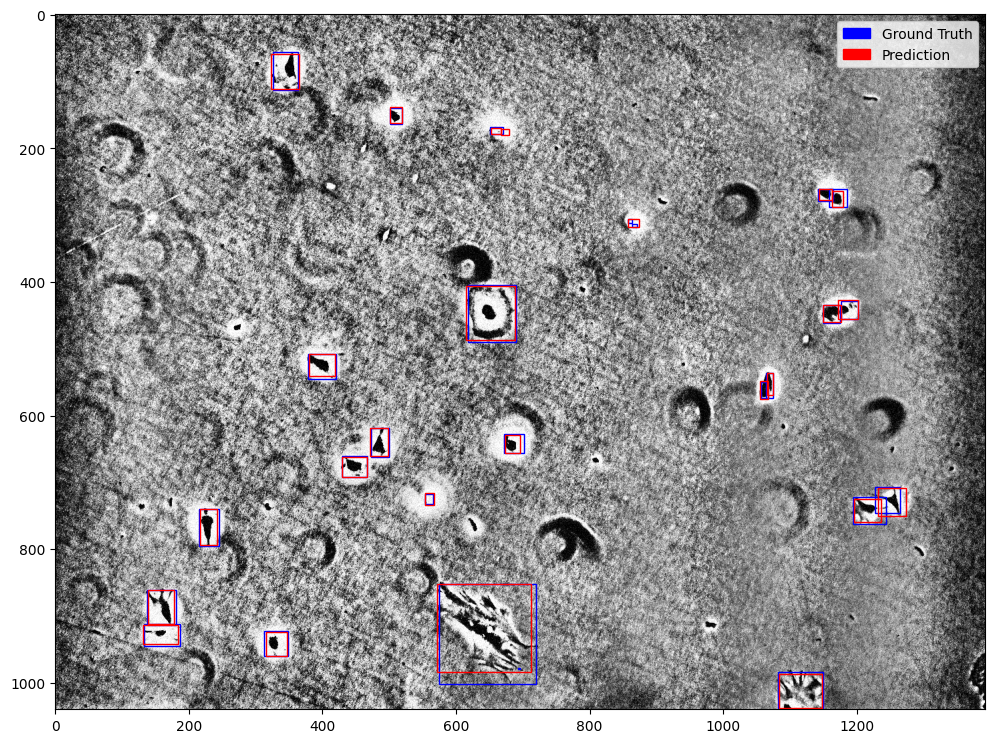

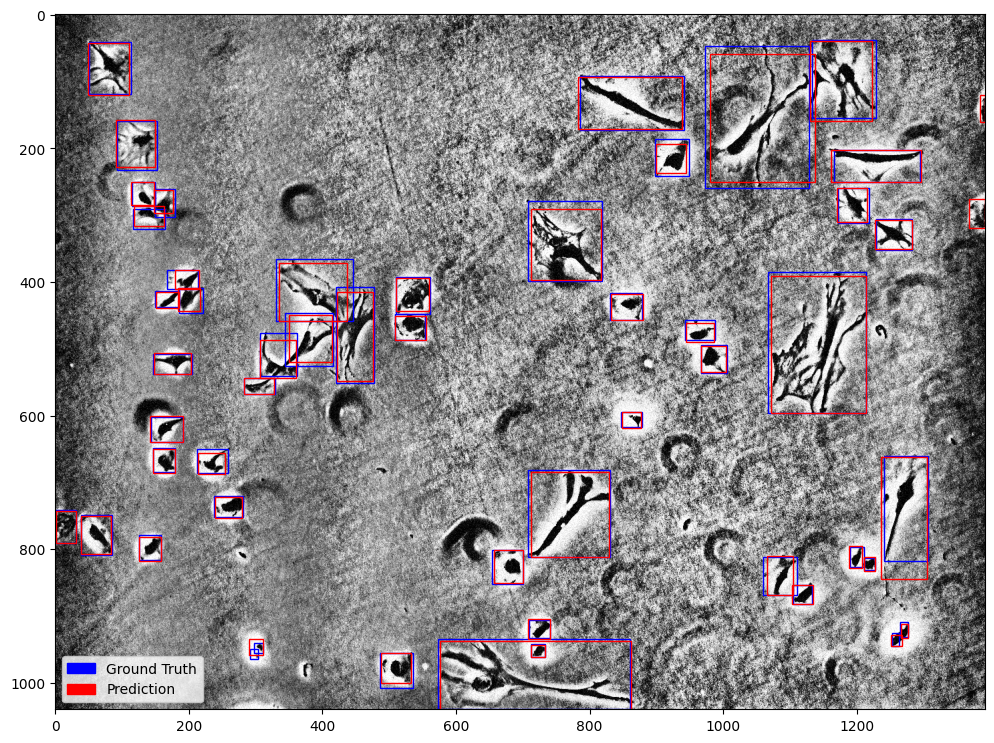

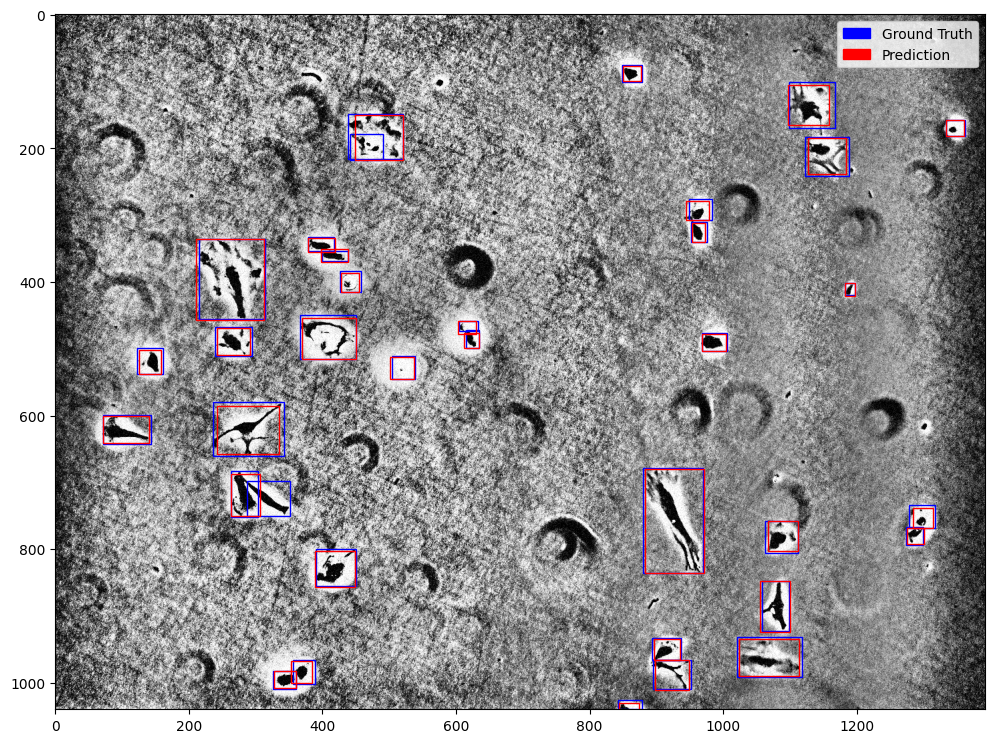

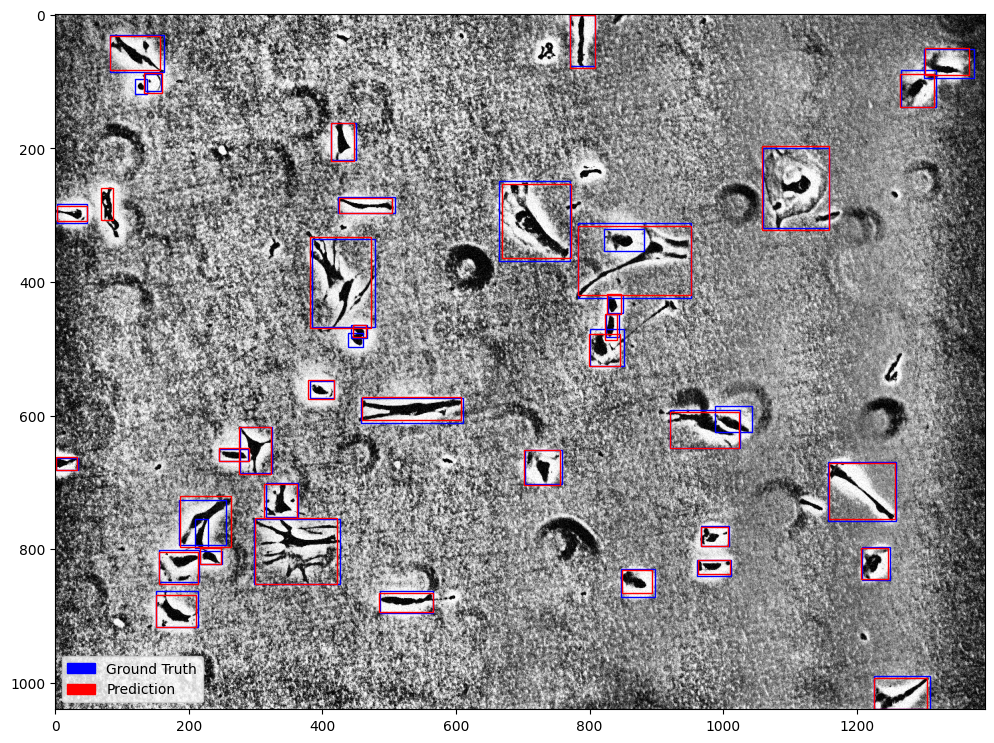

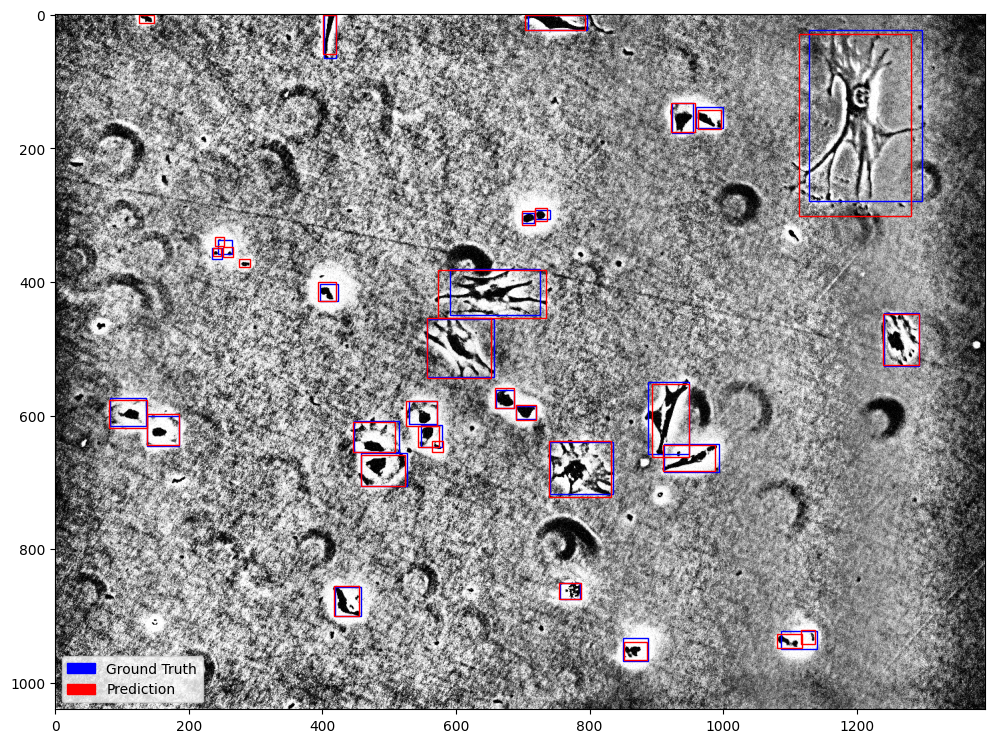

In [26]:
import torch
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from torchvision.ops import nms

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load the model
model_path = '/kaggle/input/weights-40-epochs/pytorch_model-e40.bin'  # Updated model path
model = get_model(num_classes)  # Replace with your model's initialization method
model.load_state_dict(torch.load(model_path, map_location=device))

# Specify the device
model = model.to(device)
model.eval()

# Define the NMS threshold
nms_thresh = 0.1  # You can tune this threshold

# Visualization function
def visualize_prediction(image, target, prediction):
    image_np = image.cpu().detach().permute(1, 2, 0).numpy()  # Permute to put channels last
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image_np, cmap='gray')
    
    handles = [Rectangle((0, 0), 1, 1, color='blue'),
               Rectangle((0, 0), 1, 1, color='red')]
    labels = ['Ground Truth', 'Prediction']
    
    for box in target['boxes']:
        rect = Rectangle((box[0].item(), box[1].item()),
                         box[2].item() - box[0].item(),
                         box[3].item() - box[1].item(),
                         linewidth=1, edgecolor='blue', facecolor='none')
        ax.add_patch(rect)
    
    for box in prediction['boxes']:
        rect = Rectangle((box[0].item(), box[1].item()),
                         box[2].item() - box[0].item(),
                         box[3].item() - box[1].item(),
                         linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
    
    ax.legend(handles, labels)
    plt.show()

# Initialize a counter for the visualizations
num_images_to_visualize = 5  # Replace with the number of images you want to visualize
visualized_count = 0

# Iterate over the validation dataloader
for _, _, batch_images, batch_targets, _ in validation_dataloader:
    if visualized_count >= num_images_to_visualize:
        break

    # Move batch of images to the same device as model
    batch_images = [image.to(device) for image in batch_images]

    # Get predictions for the current batch
    with torch.no_grad():
        batch_predictions = model(batch_images)
        predictions = []
        for prediction in batch_predictions:
            keep = nms(prediction['boxes'], prediction['scores'], nms_thresh)
            predictions.append({
                'boxes': prediction['boxes'][keep],
                'scores': prediction['scores'][keep],
                'labels': prediction['labels'][keep],
            })

    # Visualize predictions for the current batch
    for i in range(len(batch_images)):
        if visualized_count >= num_images_to_visualize:
            break
        visualize_prediction(batch_images[i], batch_targets[i], predictions[i])
        visualized_count += 1


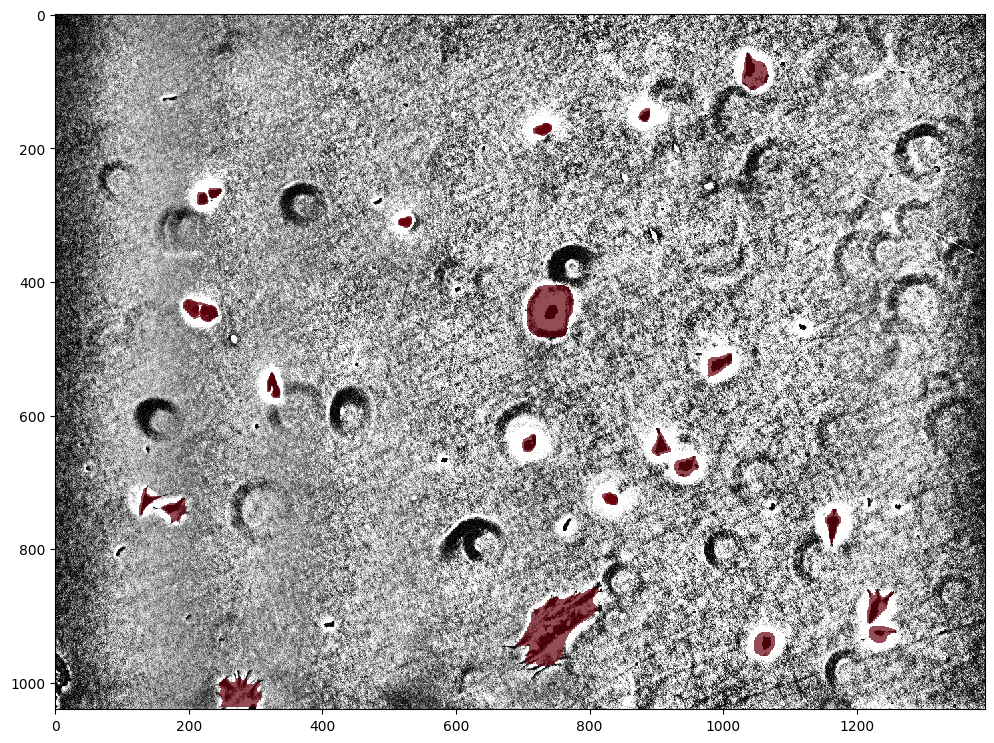

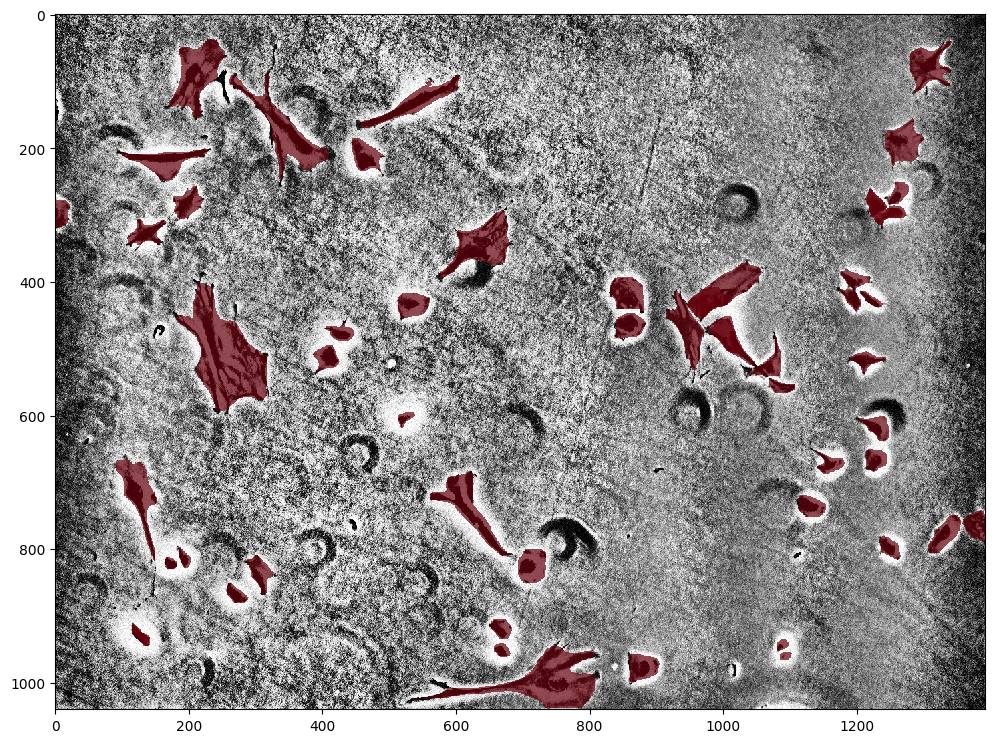

In [36]:
import matplotlib.pyplot as plt
import numpy as np

# Visualization function
def visualize_prediction(image, target, prediction):
    # Convert tensor image to numpy array
    image_np = image.cpu().detach().numpy().squeeze()  # Squeeze to remove channel dimension for grayscale

    # Create a figure and axis for plotting
    fig, ax = plt.subplots(1, figsize=(12, 12))

    # Display the image in grayscale
    ax.imshow(image_np, cmap='gray', interpolation='nearest')

    # Draw predicted masks in red to orange gradient
    for mask in prediction['masks']:
        # Squeeze to remove the leading '1' in mask shape if present
        mask_np = mask.squeeze().cpu().numpy()
        mask_np = mask_np > 0.5  # Threshold for binary mask
        mask_color = plt.cm.Reds  # Use the red colormap
        mask_color.set_under('black', alpha=0)  # Set background (under threshold) to black with no alpha
        ax.imshow(mask_np, cmap=mask_color, interpolation='none', alpha=0.7, vmin=0.5, vmax=mask_np.max())

    plt.show()

# Visualize the first few images in the batch
for i in range(min(len(images), 5)):  # Change 5 to the number of images you want to visualize
    visualize_prediction(images[i], targets[i], predictions[i])


Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[ 0.02241661,  0.08598605,  0.08729384, ..., -0.02021962,
         0.04739103, -0.05453224],
       [-0.02055841,  0.14187931, -0.12577247, ...,  0.00182837,
        -0.0710191 , -0.01033208],
       [-0.06684216, -0.00672047,  0.00257076, ..., -0.13832912,
        -0.12060741, -0.01779518],
       ...,
       [-0.04192935, -0.10022911, -0.08297712, ..., -0.00265972,
         0.13611015, -0.04351619],
       [ 0.04435709, -0.0430116 , -0.05276951, ...,  0.02250574,
        -0.04183906,  0.08809927],
       [-0.07236879,  0.01642238,  0.05277232, ...,  0.06362383,
         0.00804841,  0.03459228]])}, 'applied': True}, {'__class_fullname__': 'Ho

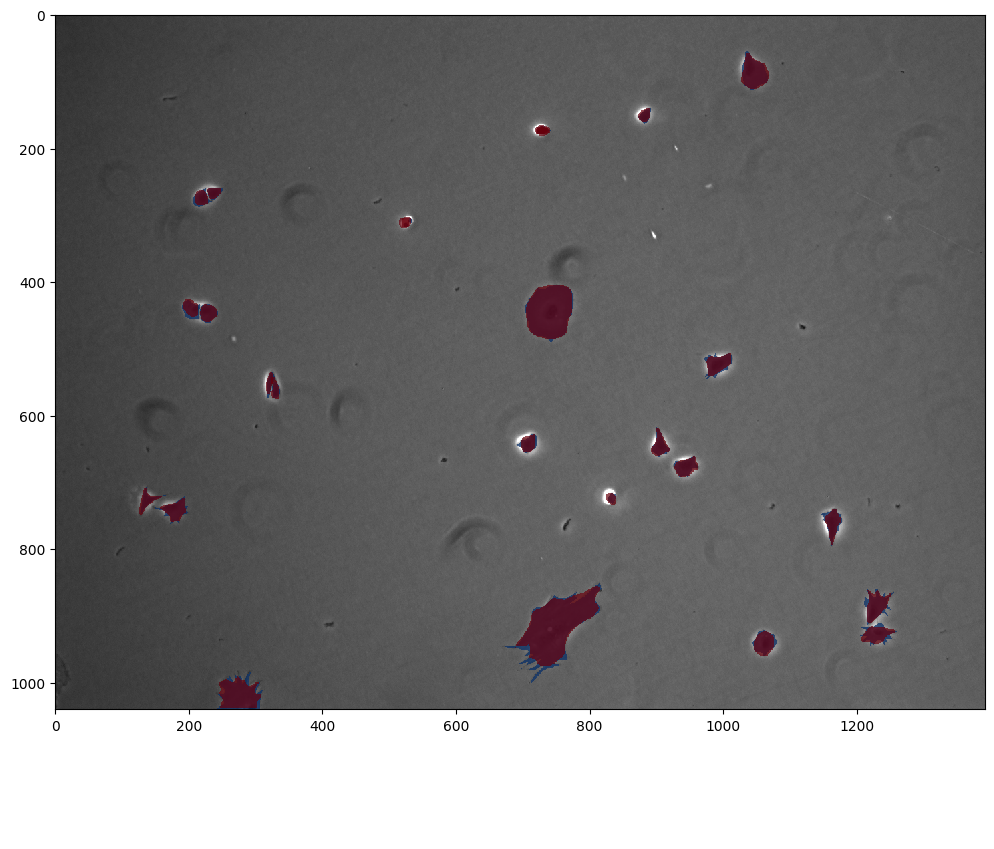

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.03022489,  0.18009857,  0.01471771, ...,  0.03384338,
         0.05153348, -0.04265634],
       [ 0.00900186, -0.01354122, -0.04482542, ...,  0.07497316,
         0.02185572,  0.03323823],
       [ 0.06708393, -0.09166596,  0.0612063 , ..., -0.07432406,
         0.04030859,  0.05506067],
       ...,
       [ 0.03579998,  0.10887512, -0.17191129, ..., -0.15255597,
        -0.00843145,  0.06913046],
       [-0.0034633 , -0.11383319, -0.11217261, ...,  0.06642507,
         0.08221546, -0.02954299],
       [-0.02153033, -0.10258845, -0.07666021, ...,  0.05085412,
        -0.15204256, -0.05700614]])}, 'applied': True}, {'__class_fullname__': 'Ho

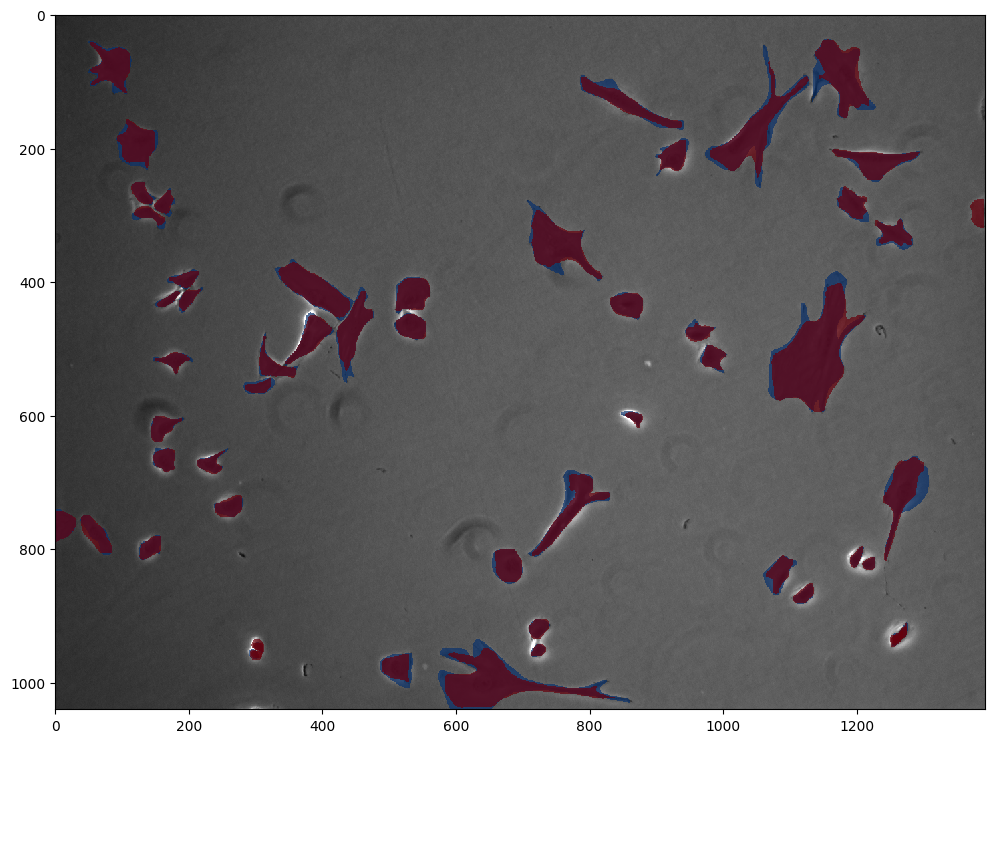

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[ 0.05904907, -0.00791701,  0.0157457 , ..., -0.01430925,
        -0.00216219, -0.09384638],
       [ 0.01897248, -0.00460094,  0.01556777, ..., -0.04974475,
        -0.05378305, -0.09845999],
       [ 0.04278649, -0.00924076, -0.11879826, ..., -0.11354515,
        -0.06914249,  0.09302318],
       ...,
       [ 0.03228004,  0.11183827, -0.14506988, ...,  0.00448398,
        -0.0846805 ,  0.04747775],
       [-0.04964255, -0.01271816,  0.00366099, ..., -0.10604962,
         0.14520952, -0.03485437],
       [ 0.01824469,  0.01148404, -0.0170402 , ...,  0.0224771 ,
         0.06783845,  0.09602873]])}, 'applied': True}, {'__class_fullname__': 'Ho

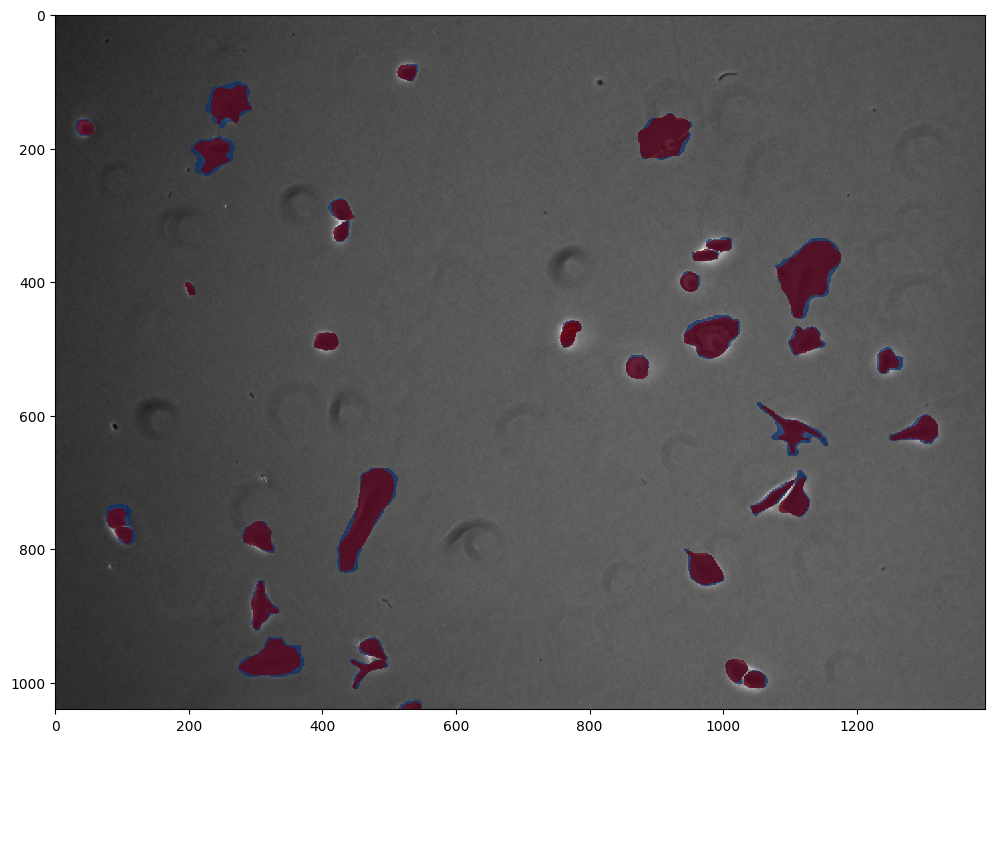

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.01019008, -0.10901622,  0.01122499, ..., -0.12852509,
         0.00561732,  0.02597507],
       [ 0.00915178,  0.04878553,  0.03659738, ..., -0.05800356,
        -0.06501598, -0.00206102],
       [-0.02468947,  0.0665128 ,  0.05409463, ..., -0.0450341 ,
        -0.02223935, -0.01567841],
       ...,
       [-0.02403987, -0.14235719, -0.04259012, ...,  0.11819995,
        -0.0314966 , -0.0433853 ],
       [ 0.01253108, -0.13160385,  0.06953172, ...,  0.06816109,
        -0.10621164,  0.11402347],
       [ 0.07726701,  0.04402746, -0.02253521, ..., -0.02331843,
         0.12621296, -0.03093445]])}, 'applied': True}, {'__class_fullname__': 'Ho

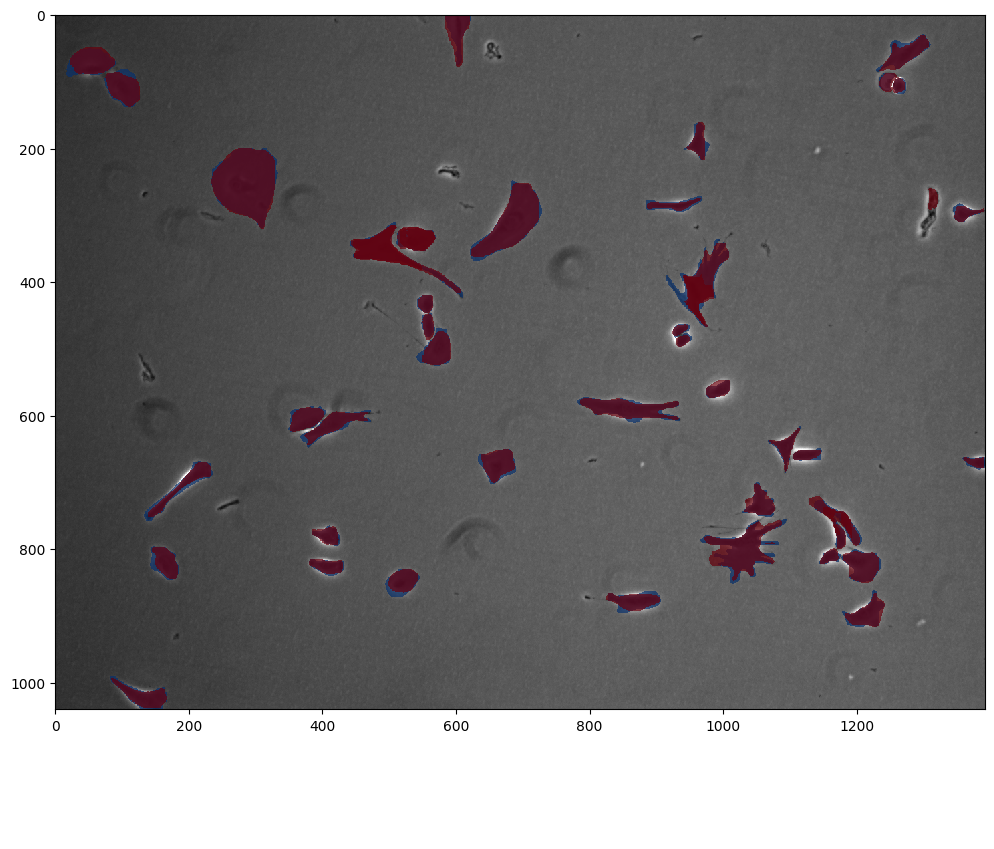

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.05032089,  0.04772713, -0.07456313, ..., -0.00480337,
        -0.01665175, -0.01191132],
       [ 0.02792512,  0.03078238, -0.09139736, ..., -0.18059741,
        -0.00671895,  0.06402456],
       [-0.08066454,  0.04393857, -0.08116842, ...,  0.09479401,
        -0.02283342,  0.01087286],
       ...,
       [-0.02991348, -0.01711424, -0.12717561, ...,  0.11376481,
         0.05894419,  0.06766705],
       [ 0.11207496,  0.05442401, -0.08606937, ..., -0.04158613,
         0.03387078,  0.02381236],
       [ 0.08420667, -0.03734955,  0.03563089, ...,  0.01216046,
        -0.03767751, -0.13195214]])}, 'applied': True}, {'__class_fullname__': 'Ho

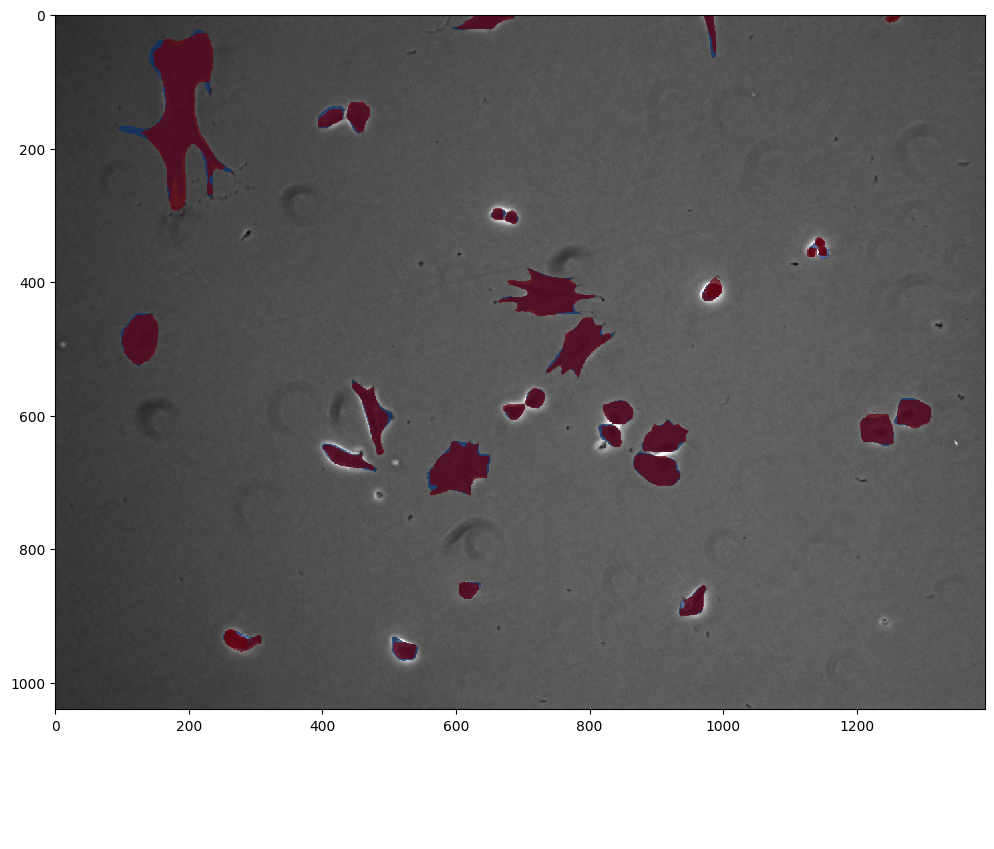

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.0661435 ,  0.10198789,  0.0452865 , ...,  0.0032457 ,
        -0.05342075,  0.12857612],
       [-0.04146156,  0.00780132, -0.03207679, ..., -0.05504868,
        -0.01030689, -0.02564785],
       [-0.03824796,  0.03236681,  0.01220989, ..., -0.0277846 ,
         0.00171796,  0.07087651],
       ...,
       [-0.04289962, -0.03820726,  0.02518853, ...,  0.04619502,
         0.01293375,  0.01302191],
       [-0.09425753, -0.09241019,  0.03262284, ...,  0.05276878,
         0.07303203, -0.01621358],
       [-0.05963459, -0.17978925,  0.01324244, ...,  0.13589529,
         0.05663254, -0.06965594]])}, 'applied': True}, {'__class_fullname__': 'Ho

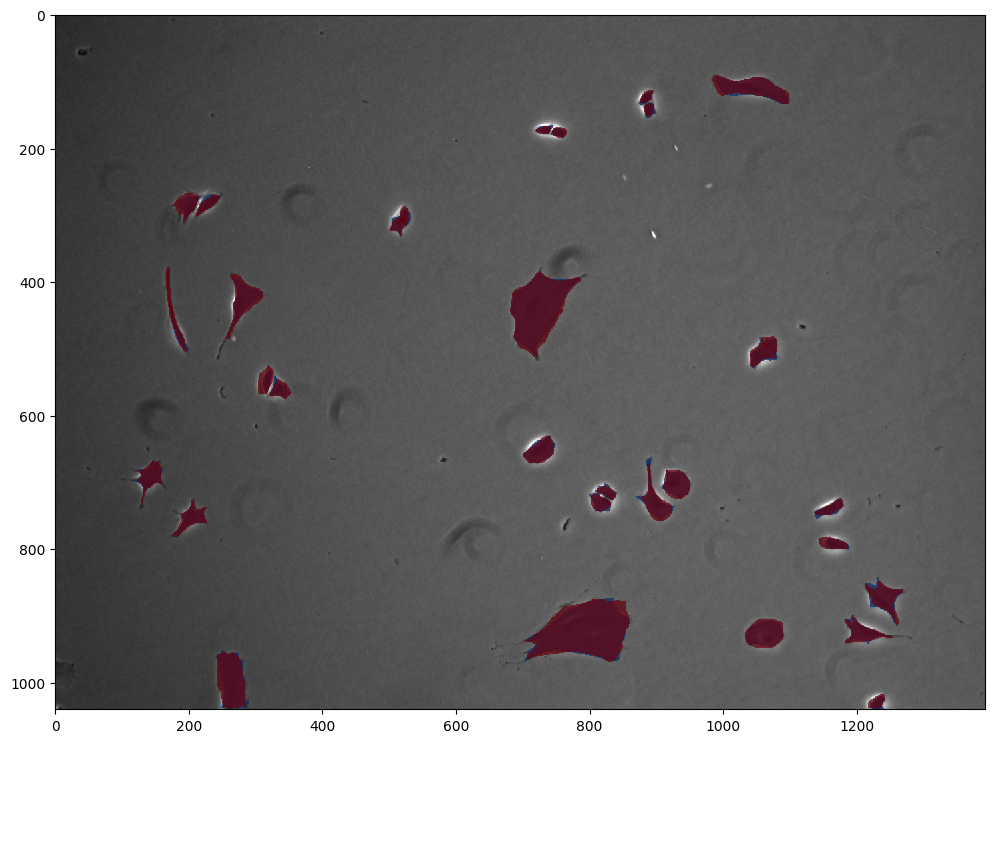

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.03995687,  0.01695789, -0.0194782 , ..., -0.04175172,
        -0.11725449, -0.0305138 ],
       [-0.05995591, -0.04637091,  0.03432726, ..., -0.05629896,
         0.04021975, -0.07537328],
       [-0.01143484, -0.09494812,  0.03259728, ..., -0.04411285,
         0.17271386, -0.11709133],
       ...,
       [ 0.12783905, -0.0127676 ,  0.08906213, ..., -0.01332769,
        -0.16397906, -0.0919908 ],
       [-0.10417874,  0.01846442, -0.13111202, ...,  0.01083969,
         0.07744917, -0.05248013],
       [-0.01397953,  0.03373153, -0.00241607, ...,  0.0695053 ,
        -0.04132476, -0.13092507]])}, 'applied': True}, {'__class_fullname__': 'Ho

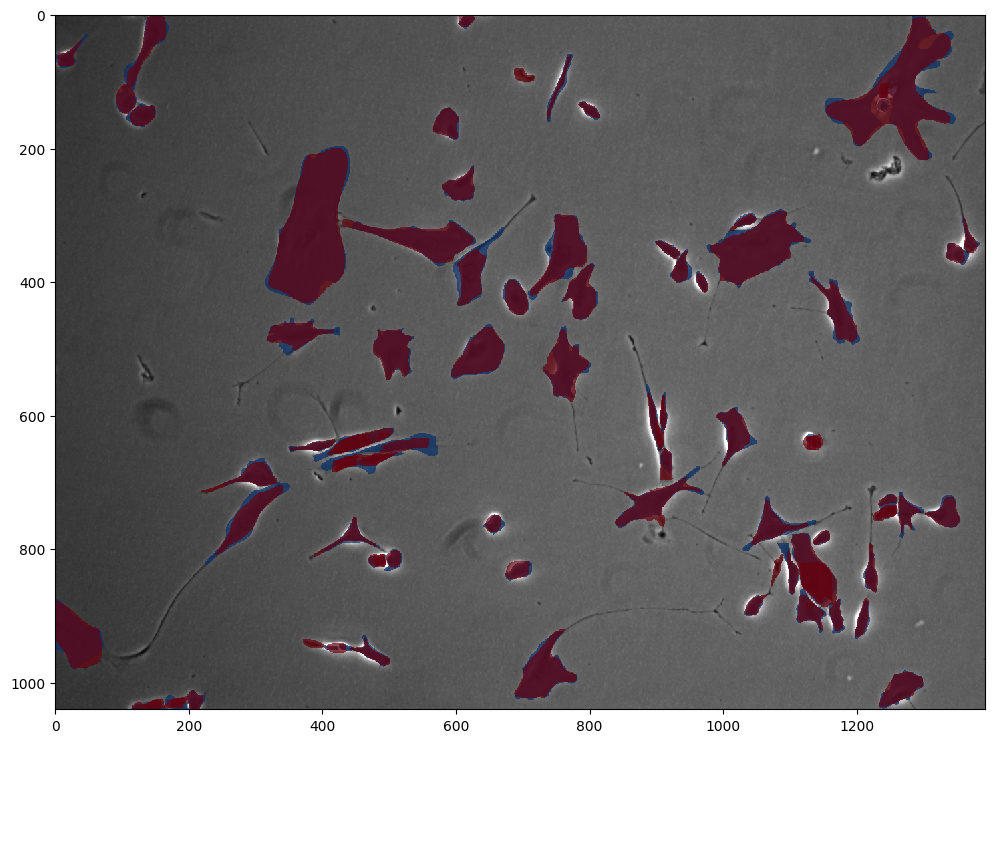

Image Parameters Dictionary:
{'__class_fullname__': 'ReplayCompose', 'params': None, 'transforms': [{'__class_fullname__': 'Lambda', '__name__': 'apply_clahe', 'params': {}, 'applied': True}, {'__class_fullname__': 'GaussNoise', 'always_apply': False, 'p': 1, 'var_limit': (0.005, 0.005), 'per_channel': True, 'mean': 0, 'params': {'gauss': array([[-0.12846096,  0.09825311,  0.07785299, ...,  0.08853497,
         0.00228697, -0.04586006],
       [ 0.08469155, -0.06778585,  0.02319012, ...,  0.07948659,
         0.03842543, -0.10698135],
       [-0.03114726,  0.02351916, -0.02466844, ...,  0.02940982,
         0.00248134, -0.08169226],
       ...,
       [ 0.00064508, -0.03849476, -0.04618191, ..., -0.04969355,
         0.11044709,  0.00902063],
       [-0.09000438, -0.05771274,  0.03339895, ..., -0.12719839,
         0.02333272,  0.02891647],
       [ 0.08420216,  0.11818534,  0.01237824, ...,  0.01504436,
         0.00659043,  0.07024214]])}, 'applied': True}, {'__class_fullname__': 'Ho

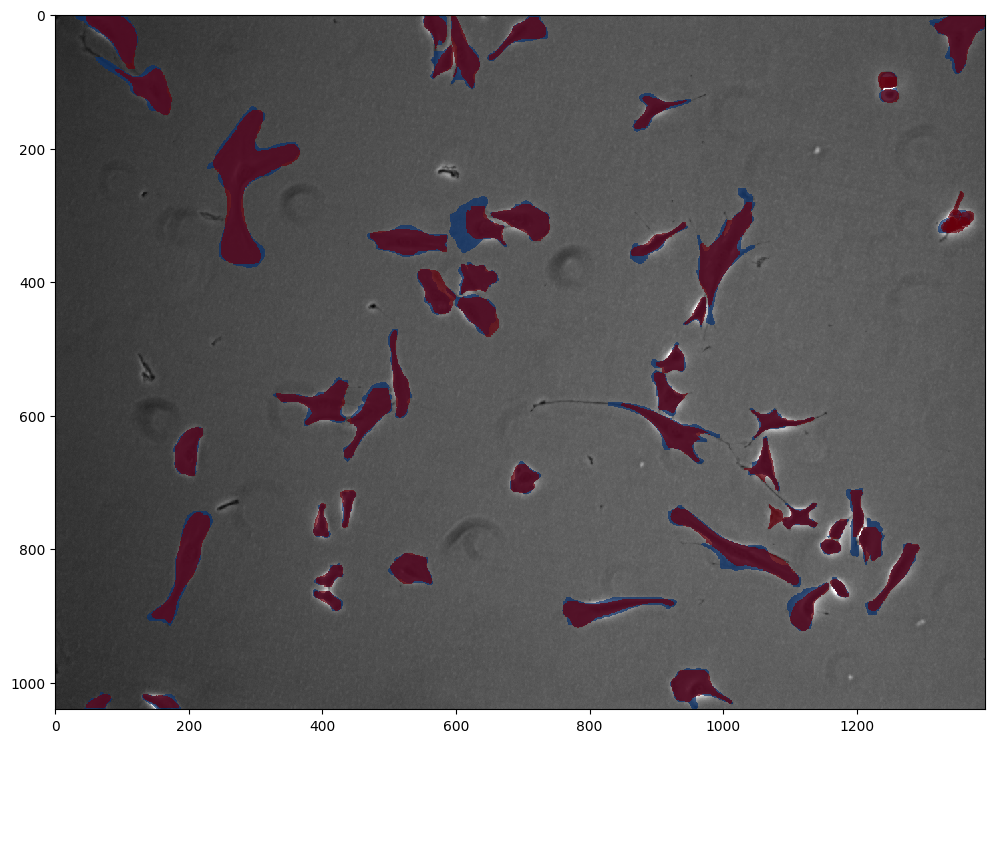

In [21]:
# Visualization function updated to handle detransformed images
def visualize_prediction_with_true_mask(original_image, prediction, true_target, flip_status):
    # Convert original image to numpy array
    image_np = original_image.cpu().detach().numpy().squeeze()  # Squeeze to remove channel dimension for grayscale

    # Extract true masks from the true_target
    true_masks = true_target['masks']

    # Create a figure and axis for plotting
    fig, ax = plt.subplots(1, figsize=(12, 12))

    # Display the original image in grayscale
    ax.imshow(image_np, cmap='gray', interpolation='nearest')

    # Draw each true mask in blue
    for true_mask in true_masks:
        true_mask_np = true_mask.cpu().numpy()
        true_mask_np = true_mask_np > 0.5  # Threshold for binary mask
        true_mask_color = plt.cm.Blues  # Use the blue colormap
        true_mask_color.set_under('black', alpha=0)  # Set background to black with no alpha
        ax.imshow(true_mask_np, cmap=true_mask_color, interpolation='none', alpha=0.7, vmin=0.5, vmax=true_mask_np.max())

    # Draw predicted masks in red to orange gradient
    for mask in prediction['masks']:
        mask_np = mask.squeeze().cpu().numpy()
        mask_np = mask_np > 0.5  # Threshold for binary mask
        mask_color = plt.cm.Reds  # Use the red colormap
        mask_color.set_under('black', alpha=0)  # Set background to black with no alpha
        ax.imshow(mask_np, cmap=mask_color, interpolation='none', alpha=0.7, vmin=0.5, vmax=mask_np.max())

    # Display flip status on the plot
    plt.text(0.5, 0.1, f'Flip Status: {flip_status}', transform=plt.gcf().transFigure, color='white')

    plt.show()


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Number of images to visualize
num_images_to_visualize = 8
visualized_count = 0

# Function to check if the image was flipped
def was_image_flipped(image_tensor, params):
    flip_status = False
    for transform in params.get('transforms', []):
        if transform.get('__class_fullname__', "") == 'HorizontalFlip':
            flip_status = transform.get('applied', False)
            break

    if flip_status:
        original_image = reverse_flip(image_tensor, flip_status)
        flipped_image = image_tensor
        return not torch.allclose(original_image, flipped_image)

    return False

# Function to reverse flip on predictions
def reverse_flip_on_predictions(prediction, flip_status):
    if flip_status:
        # Reverse flip the masks
        reversed_masks = [torch.flip(mask, dims=[-1]) for mask in prediction['masks']]
        # Update the prediction with reversed masks
        prediction['masks'] = reversed_masks


    return prediction

def reverse_flip(image_tensor, flip_status):
    if flip_status:

        # Flip the image tensor horizontally
        return torch.flip(image_tensor, dims=[-1])
    else:
        # If no flip was applied, return the image as is
        return image_tensor


# Loop over batches in the dataloader
for original_images, original_targets, images, _, params in validation_dataloader:
    images = [image.to(device) for image in images]

    with torch.no_grad():
        predictions = model(images)
    
    for i in range(len(original_images)):
        # Determine if the image was flipped during preprocessing
        flip_status = was_image_flipped(images[i], params[i])

        # Reverse the flip on this prediction if necessary
        corrected_prediction = reverse_flip_on_predictions(predictions[i], flip_status)

        print("Image Parameters Dictionary:")
        print(params[i])
        
        print(f'HorizontalFlip Applied: {flip_status}')

        # Visualize with the original image and possibly detransformed predictions
        visualize_prediction_with_true_mask(original_images[i], corrected_prediction, original_targets[i], flip_status)
        
        visualized_count += 1
        if visualized_count >= num_images_to_visualize:
            break
    if visualized_count >= num_images_to_visualize:
        break

